**MODULE IMPORTING**

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pathlib
import os
import cv2
import tensorflow as tf
from tensorflow import keras
import seaborn as sns
%matplotlib inline

**FETCHING THE DATASET**

**DATASET DOWNLOADED FROM**
https://www.kaggle.com/dhruvmak/face-mask-detection

In [3]:
#base directory 
base_dir = r'C:/Users/upadh/Desktop/programs/machine learning/mask detection project/dataset kaggle'

In [4]:
print(base_dir)

C:/Users/upadh/Desktop/programs/machine learning/mask detection project/dataset kaggle


In [5]:
categories = os.listdir(base_dir)
print(categories)

['without_mask', 'with_mask']


In [6]:
categorical_labels = [i for i in range(len(categories))]
dct_label = dict(zip(categories,categorical_labels))

In [7]:
print(dct_label)
print(categorical_labels)

{'without_mask': 0, 'with_mask': 1}
[0, 1]


In [8]:
img_size = 100
mask_data = []
mask_target = []

In [9]:
#fetching the MASK and WITHOUT MASK images from dataset folder and converting it to grayscale and appending in mask_data 

for category in categories:
    mask_img_dir = os.path.join(base_dir,category)
    train_image = os.listdir(mask_img_dir)
    
    for image in train_image:
        train_img_path = os.path.join(mask_img_dir,image)
        train_img = cv2.imread(train_img_path)

        gray = cv2.cvtColor(train_img,cv2.COLOR_BGR2GRAY)
        resized=cv2.resize(gray,(img_size,img_size))
        mask_data.append(resized)
        mask_target.append(dct_label[category])

**UNDERSTANDING THE DATASET**

In [13]:
len(mask_data)

440

In [14]:
mask_target[0]

0

In [15]:
mask_data

[array([[255, 255, 255, ..., 255, 255, 255],
        [255, 255, 255, ..., 255, 255, 255],
        [255, 255, 255, ..., 255, 255, 255],
        ...,
        [255, 255, 255, ...,  19,  35,  28],
        [255, 255, 255, ...,  27,  39,  28],
        [255, 255, 255, ...,  35,  32,  28]], dtype=uint8),
 array([[229, 229, 230, ..., 238, 238, 237],
        [229, 230, 230, ..., 238, 238, 238],
        [229, 230, 230, ..., 238, 238, 238],
        ...,
        [228, 227, 227, ..., 238, 237, 238],
        [227, 228, 223, ..., 237, 237, 237],
        [222, 225, 223, ..., 236, 236, 237]], dtype=uint8),
 array([[191, 191, 191, ..., 153, 155, 157],
        [191, 191, 191, ..., 154, 155, 157],
        [192, 192, 192, ..., 155, 156, 157],
        ...,
        [252, 251, 250, ..., 185, 186, 190],
        [255, 254, 253, ..., 186, 187, 190],
        [255, 255, 254, ..., 187, 188, 190]], dtype=uint8),
 array([[185, 201, 203, ..., 218, 219, 219],
        [ 90, 196, 201, ..., 215, 217, 218],
        [ 51, 16

In [16]:
mask_target

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,


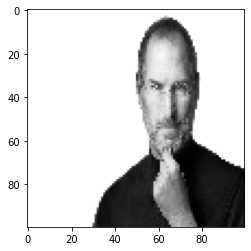

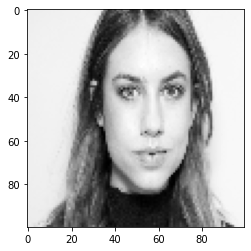

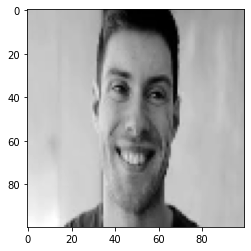

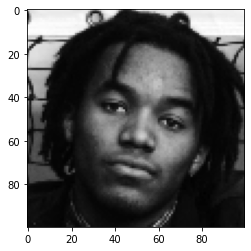

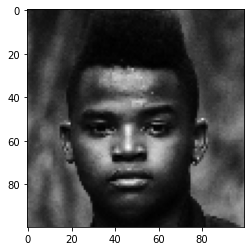

...

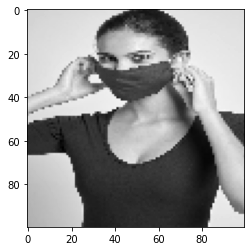

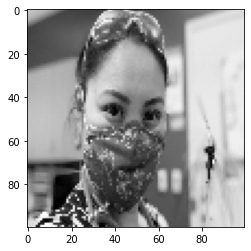

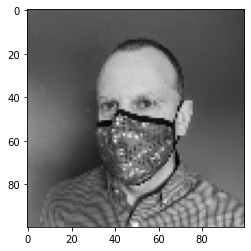

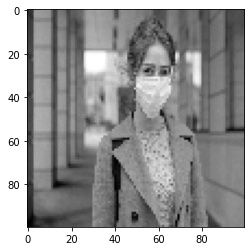

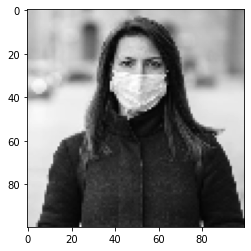

In [23]:
# converting arrays in mask_data back to grayscale image using PIL module

from PIL import Image
for i in range(len(mask_data)):
    temp = Image.fromarray(mask_data[i])
    plt.imshow(temp,cmap = 'gray')
    plt.show()


In [24]:
#length finding of the lists
len(mask_data),len(mask_target)

(440, 440)

In [25]:
mask_data[0].shape

(100, 100)

**NORMALIZATION OF DATASET**

In [19]:
#dividing the mask_data by 255 to convert the pixel between 0 and 1
mask_data = np.array(mask_data)/255.0

#reshape the mask_data in 4d as NN accepts 4d arrays
mask_data=np.reshape(mask_data,(mask_data.shape[0],img_size,img_size,1))
mask_target = np.array(mask_target)

from tensorflow.keras.utils import to_categorical
mask_target = to_categorical(mask_target)

In [20]:
mask_data.shape[0]

440

In [21]:
mask_data.shape[1:]

(100, 100, 1)

In [22]:
mask_target.shape

(440, 2)

In [23]:
mask_target

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.

**CNN MODEL**

In [24]:
#training the CNN 
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense,Activation,Flatten,Dropout
from tensorflow.keras.layers import Conv2D, MaxPooling2D
#from tensorflow.keras.callbacks import ModelCheckpoint

model = Sequential()

#the first CNN with activation Relu and maxpoolong layers
model.add(Conv2D(256,3,3,activation = 'relu',input_shape = (img_size,img_size,1)))
model.add(MaxPooling2D(pool_size = (2,2)))

#the second CNN layer
model.add(Conv2D(128,3,3,activation = 'relu'))
model.add(MaxPooling2D(pool_size = (2,2)))

#third CNN layer
model.add(Conv2D(64,3,3,padding = 'same',activation = 'relu'))
model.add(MaxPooling2D(2,2,padding = 'same'))

#the Flatten layer to stack the output from second CNN
model.add(Flatten())

#dropout layer added to reduce the over fitting
model.add(Dropout(0.5))

#dense layer with 64 neurons
model.add(Dense(10,activation = 'relu'))

#dense layer with 2 output for two categories
model.add(Dense(2,activation = 'softmax'))

#from tensorflow.keras.optimizers import RMSprop
model.compile(loss = 'categorical_crossentropy',optimizer = 'adam',metrics=['acc'])

In [25]:
mask_data.shape[1:]

(100, 100, 1)

In [26]:
mask_data

array([[[[1.        ],
         [1.        ],
         [1.        ],
         ...,
         [1.        ],
         [1.        ],
         [1.        ]],

        [[1.        ],
         [1.        ],
         [1.        ],
         ...,
         [1.        ],
         [1.        ],
         [1.        ]],

        [[1.        ],
         [1.        ],
         [1.        ],
         ...,
         [1.        ],
         [1.        ],
         [1.        ]],

        ...,

        [[1.        ],
         [1.        ],
         [1.        ],
         ...,
         [0.0745098 ],
         [0.1372549 ],
         [0.10980392]],

        [[1.        ],
         [1.        ],
         [1.        ],
         ...,
         [0.10588235],
         [0.15294118],
         [0.10980392]],

        [[1.        ],
         [1.        ],
         [1.        ],
         ...,
         [0.1372549 ],
         [0.1254902 ],
         [0.10980392]]],


       [[[0.89803922],
         [0.89803922],
         [0.90

In [27]:
mask_target

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.

In [28]:
mask_data.shape

(440, 100, 100, 1)

In [37]:
mask_target.shape

(440, 2)

**TRAINING THE MODEL**

In [29]:
from sklearn.model_selection import train_test_split
train_mask_data,test_mask_data,train_mask_target,test_mask_target = train_test_split(mask_data,mask_target,test_size = 0.2)

In [30]:
history = model.fit(train_mask_data,train_mask_target,validation_split = 0.2,epochs = 20)

Train on 281 samples, validate on 71 samples
Epoch 1/20
281/281 [==============================] - 2s 9ms/sample - loss: 0.6968 - acc: 0.5018 - val_loss: 0.6966 - val_acc: 0.4648
Epoch 2/20
281/281 [==============================] - 1s 4ms/sample - loss: 0.7011 - acc: 0.4698 - val_loss: 0.6905 - val_acc: 0.4648
Epoch 3/20
281/281 [==============================] - 1s 4ms/sample - loss: 0.6903 - acc: 0.5445 - val_loss: 0.6848 - val_acc: 0.4648
Epoch 4/20
281/281 [==============================] - 1s 4ms/sample - loss: 0.6846 - acc: 0.5409 - val_loss: 0.6794 - val_acc: 0.4648
Epoch 5/20
281/281 [==============================] - 1s 4ms/sample - loss: 0.6695 - acc: 0.5907 - val_loss: 0.6826 - val_acc: 0.4648
Epoch 6/20
281/281 [==============================] - 1s 4ms/sample - loss: 0.6615 - acc: 0.5730 - val_loss: 0.6486 - val_acc: 0.5775
Epoch 7/20
281/281 [==============================] - 1s 4ms/sample - loss: 0.6593 - acc: 0.6263 - val_loss: 0.6133 - val_acc: 0.7465
Epoch 8/20
281/28

In [31]:
print(model.evaluate(test_mask_data,test_mask_target))

88/88 [==============================] - 0s 1ms/sample - loss: 0.4729 - acc: 0.7955
[0.47290153395045886, 0.79545456]


**VISUALIZATION**

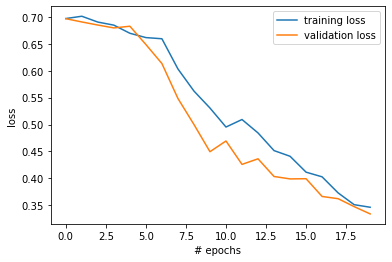

In [35]:
from matplotlib import pyplot as plt

plt.plot(history.history['loss'],label='training loss')
plt.plot(history.history['val_loss'],label='validation loss')
plt.xlabel('epochs')
plt.ylabel('loss')
plt.legend()
plt.show()

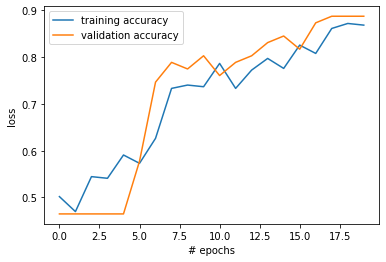

In [36]:
plt.plot(history.history['acc'],label='training accuracy')
plt.plot(history.history['val_acc'],label='validation accuracy')
plt.xlabel('# epochs')
plt.ylabel('loss')
plt.legend()
plt.show()

**REAL TIME DETECTION**

In [38]:
face_classifier=cv2.CascadeClassifier('haarcascade_frontalface_default.xml')

source=cv2.VideoCapture(0)
#img_size = 200

labels_dict={0:'mask',1:'No Mask'}
#Red for No Mask and Green for Mask
color_dict={0:(0,255,0),1:(0,0,255)} 

while(True):
    ret,img=source.read()
    gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    faces=face_classifier.detectMultiScale(gray,1.3,5)  

    for (x,y,w,h) in faces:
    
        face_img=gray[y:y+h,x:x+w]
        resized=cv2.resize(face_img,(img_size,img_size))
        normalized=resized/255.0
        reshaped=np.reshape(normalized,(1,img_size,img_size,1))
        result=model.predict(reshaped)

        label=np.argmax(result,axis=1)[0]
      
        cv2.rectangle(img,(x,y),(x+w,y+h),color_dict[label],2)
        cv2.rectangle(img,(x,y-40),(x+w,y),color_dict[label],-1)
        cv2.putText(img, labels_dict[label], (x, y-10),cv2.FONT_HERSHEY_SIMPLEX,0.8,(255,255,255),2)
        
        
    cv2.imshow('real time',img)
    key=cv2.waitKey(1)
    
    # press ESC to exit the video program
    if(key==27):
        break
        
cv2.destroyAllWindows()
source.release()